<a href="https://colab.research.google.com/github/shumail1460/Digital-Signal-Processing/blob/main/DSP_Lab_7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import scipy.signal as signal
import matplotlib.pyplot as plt
from scipy.fftpack import fft, fftshift

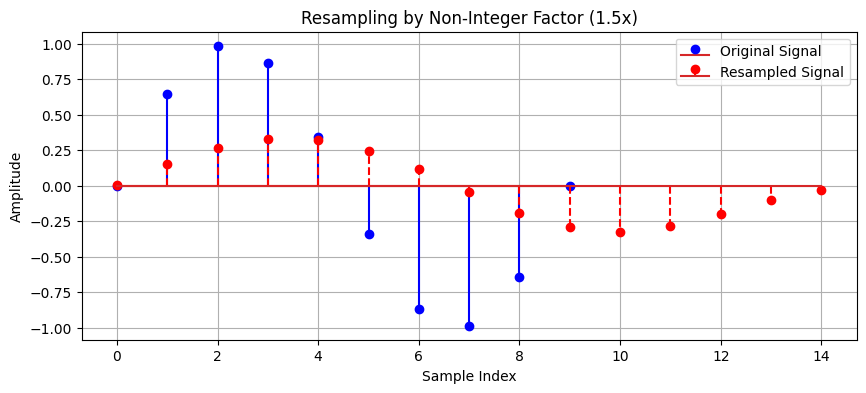

In [ ]:
# Original signal
x = np.sin(2 * np.pi * np.linspace(0, 1, 10))  # 10 samples
L, M = 3, 2  # Upsample by 3, then downsample by 2

# Step 1: Upsampling (Insert Zeros)
x_up = np.zeros(L * len(x))
x_up[::L] = x

# Step 2: Apply Anti-Imaging Low-Pass Filter
cutoff = min(1 / (2 * L), 1 / (2 * M))  # Combined filter cutoff
b, a = signal.butter(4, cutoff, btype='low')  # Butterworth filter
x_filtered = signal.filtfilt(b, a, x_up)

# Step 3: Downsampling (Keep Every Mth Sample)
x_resampled = x_filtered[::M]

# Plot Results
plt.figure(figsize=(10, 4))
plt.stem(range(len(x)), x, linefmt='b-', markerfmt='bo', label='Original Signal')
plt.stem(range(len(x_resampled)), x_resampled, linefmt='r--', markerfmt='ro', label='Resampled Signal')
plt.legend()
plt.title("Resampling by Non-Integer Factor (1.5x)")
plt.xlabel("Sample Index")
plt.ylabel("Amplitude")
plt.grid(True)
plt.show()

# **LAB TASK :**

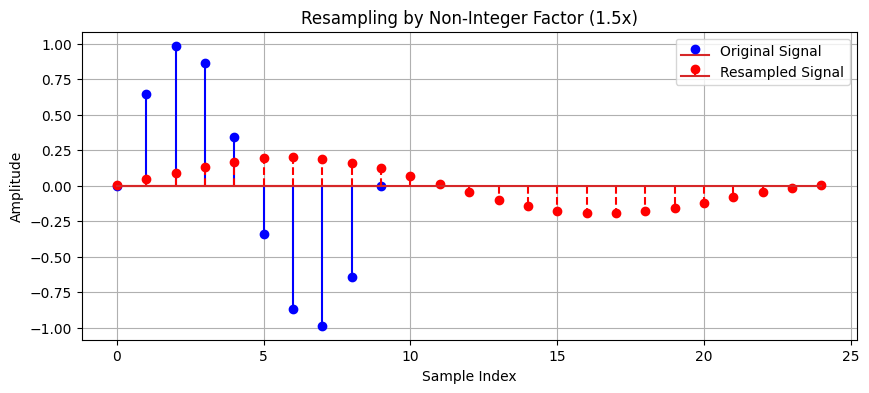

In [ ]:
# Original signal
x = np.sin(2 * np.pi * np.linspace(0, 1, 10))  # 10 samples
L, M = 5, 2  # Upsample by 3, then downsample by 2

# Step 1: Upsampling (Insert Zeros)
x_up = np.zeros(L * len(x))
x_up[::L] = x

# Step 2: Apply Anti-Imaging Low-Pass Filter
cutoff = min(1 / (2 * L), 1 / (2 * M))  # Combined filter cutoff
b, a = signal.butter(4, cutoff, btype='low')  # Butterworth filter
x_filtered = signal.filtfilt(b, a, x_up)

# Step 3: Downsampling (Keep Every Mth Sample)
x_resampled = x_filtered[::M]

# Plot Results
plt.figure(figsize=(10, 4))
plt.stem(range(len(x)), x, linefmt='b-', markerfmt='bo', label='Original Signal')
plt.stem(range(len(x_resampled)), x_resampled, linefmt='r--', markerfmt='ro', label='Resampled Signal')
plt.legend()
plt.title("Resampling by Non-Integer Factor (1.5x)")
plt.xlabel("Sample Index")
plt.ylabel("Amplitude")
plt.grid(True)
plt.show()

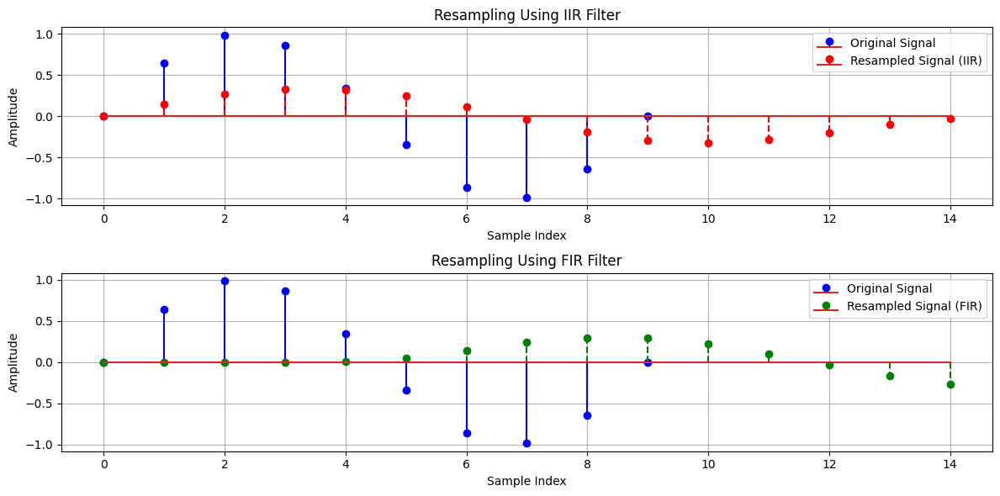

In [ ]:
# Original signal
x = np.sin(2 * np.pi * np.linspace(0, 1, 10))  # 10 samples
L, M = 3, 2  # Upsample by 3, then downsample by 2

# Step 1: Upsampling (Insert Zeros)
x_up = np.zeros(L * len(x))
x_up[::L] = x

# Step 2: Apply Anti-Imaging Low-Pass Filters
cutoff = min(1 / (2 * L), 1 / (2 * M))  # Combined filter cutoff

# IIR Filter (Butterworth)
b_iir, a_iir = signal.butter(4, cutoff, btype='low')
x_filtered_iir = signal.filtfilt(b_iir, a_iir, x_up)

# FIR Filter (Windowed Sinc)
num_taps = 21  # Number of filter taps
b_fir = signal.firwin(num_taps, cutoff)
x_filtered_fir = signal.lfilter(b_fir, 1.0, x_up)

# Step 3: Downsampling (Keep Every Mth Sample)
x_resampled_iir = x_filtered_iir[::M]
x_resampled_fir = x_filtered_fir[::M]

# Plot Results
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.stem(range(len(x)), x, linefmt='b-', markerfmt='bo', label='Original Signal')
plt.stem(range(len(x_resampled_iir)), x_resampled_iir, linefmt='r--', markerfmt='ro', label='Resampled Signal (IIR)')
plt.legend()
plt.title("Resampling Using IIR Filter")
plt.xlabel("Sample Index")
plt.ylabel("Amplitude")
plt.grid(True)

plt.subplot(2, 1, 2)
plt.stem(range(len(x)), x, linefmt='b-', markerfmt='bo', label='Original Signal')
plt.stem(range(len(x_resampled_fir)), x_resampled_fir, linefmt='g--', markerfmt='go', label='Resampled Signal (FIR)')
plt.legend()
plt.title("Resampling Using FIR Filter")
plt.xlabel("Sample Index")
plt.ylabel("Amplitude")
plt.grid(True)

plt.tight_layout()
plt.show()


# **IIR (Butterworth):**
Faster computation with a smooth response.
Introduces some phase distortion.
Suitable when real-time processing is needed with minimal computation.

# **FIR (Windowed Sinc):**
More accurate frequency cutoff and avoids phase distortion.
Higher computational cost (longer filter length).
Best for applications where phase linearity is important, such as audio processing.
# **Visual Analysis:**
The IIR-resampled signal retains the general shape but might introduce slight phase shifts.
The FIR-resampled signal maintains the original waveform shape better but introduces a longer delay.
# **Conclusion:**
If you need high precision and linear phase, go for FIR.
If you need low computational cost and real-time efficiency, go for IIR.

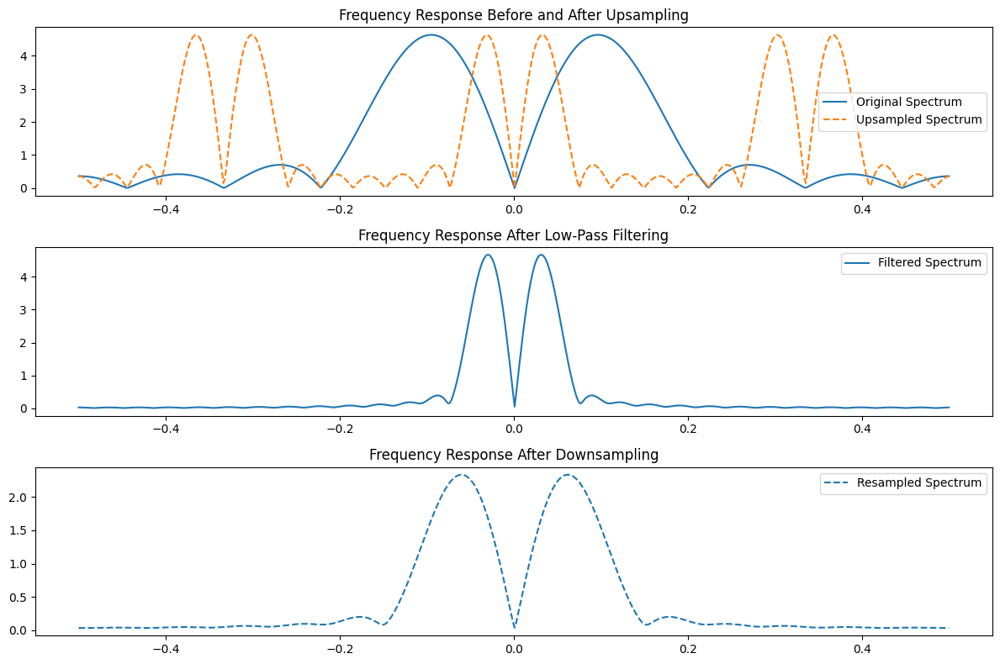

In [ ]:
# Original signal
x = np.sin(2 * np.pi * np.linspace(0, 1, 10))  # 10 samples
L, M = 3, 2  # Upsample by 3, then downsample by 2

# Step 1: Upsampling (Insert Zeros)
x_up = np.zeros(L * len(x))
x_up[::L] = x

# Step 2: Apply Anti-Imaging Low-Pass Filter
cutoff = min(1 / (2 * L), 1 / (2 * M))  # Combined filter cutoff
b, a = signal.butter(4, cutoff, btype='low')  # Butterworth filter
x_filtered = signal.filtfilt(b, a, x_up)

# Step 3: Downsampling (Keep Every Mth Sample)
x_resampled = x_filtered[::M]

# Compute Frequency Response
N_fft = 512
freqs = np.linspace(-0.5, 0.5, N_fft)  # Normalized frequency axis
X_f = fftshift(abs(fft(x, N_fft)))
X_up_f = fftshift(abs(fft(x_up, N_fft)))
X_filt_f = fftshift(abs(fft(x_filtered, N_fft)))
X_resampled_f = fftshift(abs(fft(x_resampled, N_fft)))

# Plot Frequency-Domain Results
plt.figure(figsize=(12, 8))
plt.subplot(3, 1, 1)
plt.plot(freqs, X_f, label='Original Spectrum')
plt.plot(freqs, X_up_f, linestyle='dashed', label='Upsampled Spectrum')
plt.legend()
plt.title("Frequency Response Before and After Upsampling")

plt.subplot(3, 1, 2)
plt.plot(freqs, X_filt_f, label='Filtered Spectrum')
plt.legend()
plt.title("Frequency Response After Low-Pass Filtering")

plt.subplot(3, 1, 3)
plt.plot(freqs, X_resampled_f, linestyle='dashed', label='Resampled Spectrum')
plt.legend()
plt.title("Frequency Response After Downsampling")

plt.tight_layout()
plt.show()


We can swap the order of upsampling (\( L \)) and downsampling (\( M \)) in certain cases without affecting the final result. The key condition for this is:

✅ **Swapping is possible if** \( L \) and \( M \) have no common factors except 1 (i.e., they are **coprime** or **relatively prime**).

### 🔍 **Why?**
- Upsampling by \( L \) introduces \( L-1 \) zeros between each sample.
- Downsampling by \( M \) keeps every \( M \)th sample, discarding the rest.
- If \( L \) and \( M \) share common factors, some inserted zeros may align with removed samples, leading to **different aliasing effects** in the frequency domain.
- If they are **coprime**, the overall resampling ratio \( \frac{L}{M} \) remains the same regardless of the order.

### 🔢 **Example Cases:**
#### ✅ **Swappable Order (L and M are coprime)**
- \( L = 3, M = 2 \) → No common factors except 1 → Order swapping is possible.
- \( L = 5, M = 3 \) → No common factors except 1 → Order swapping is possible.

#### ❌ **Non-Swappable Order (L and M share factors)**
- \( L = 4, M = 2 \) → Common factor = 2 → Swapping changes the frequency characteristics.
- \( L = 6, M = 3 \) → Common factor = 3 → Swapping is not recommended.

Would you like to see a code-based verification of this? 🚀

Loaded audio: /content/MAN.wav at 44100 Hz


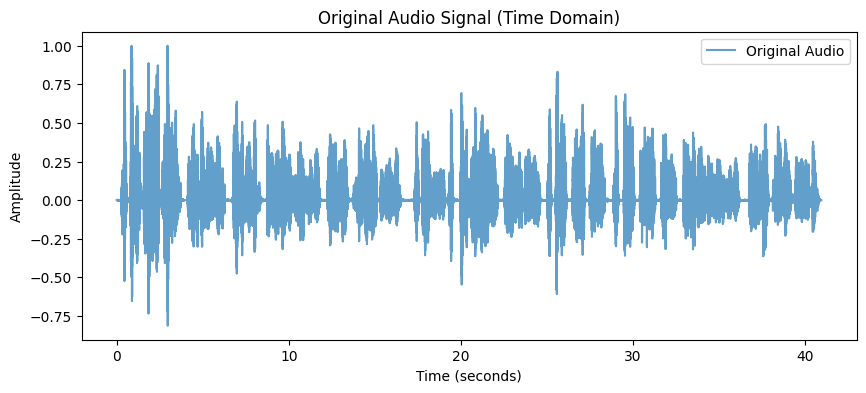

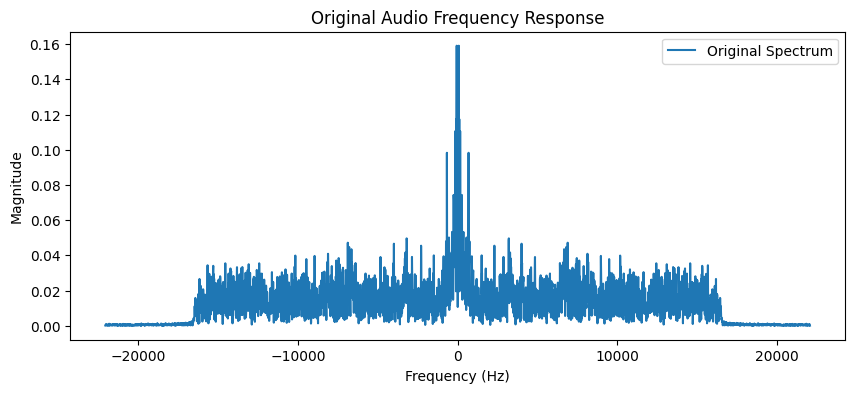

Playing original audio...


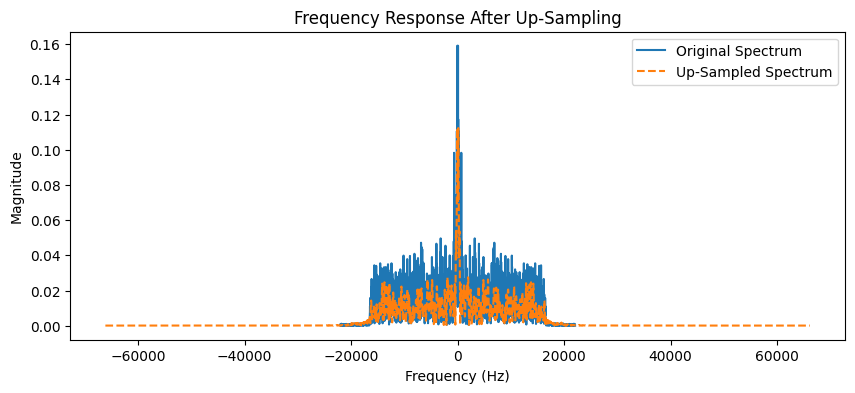

Playing upsampled audio (higher quality, slower speed)...


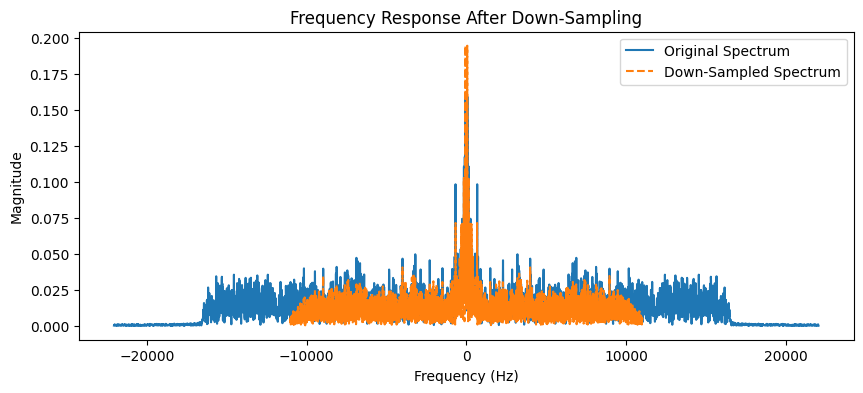

Playing downsampled audio (lower quality, faster speed)...


/usr/local/lib/python3.11/dist-packages/matplotlib/axes/_axes.py:8233: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


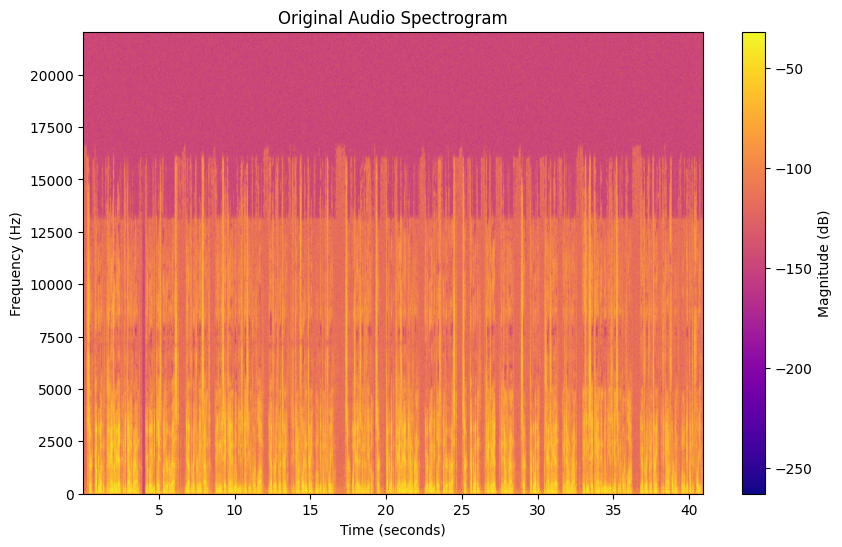

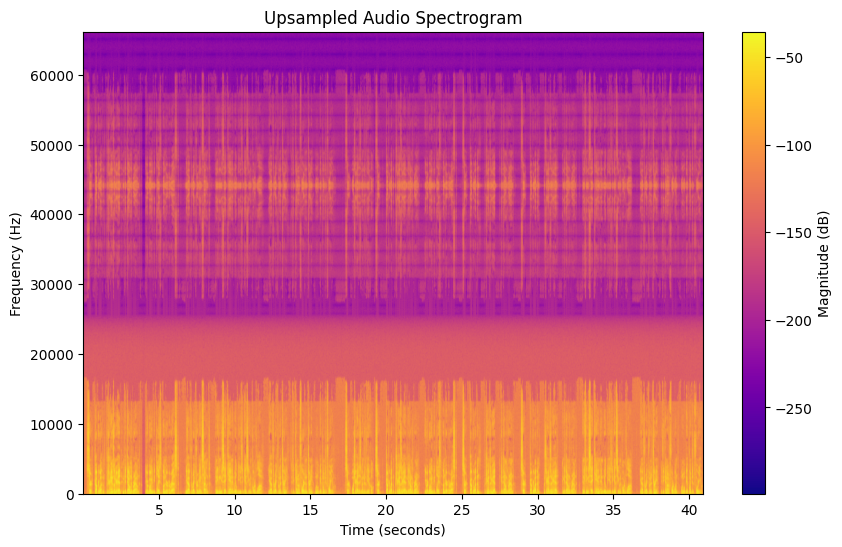

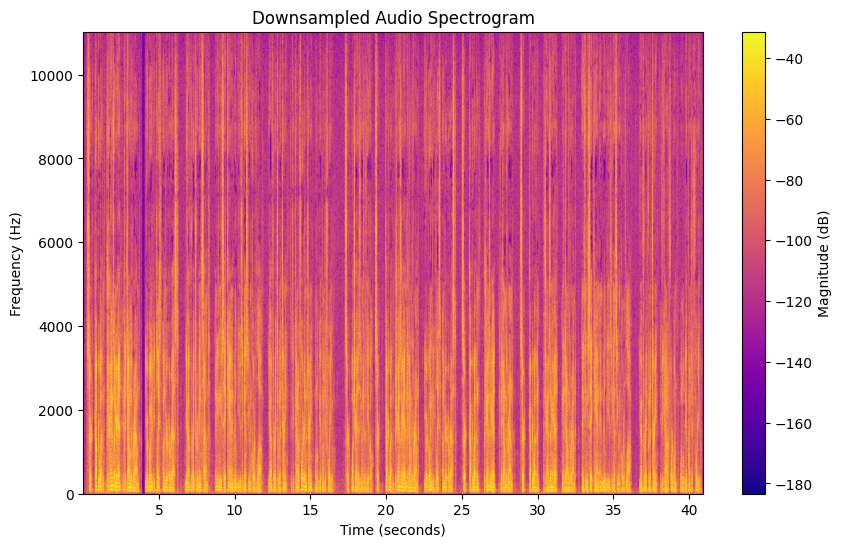

In [ ]:
import os
import numpy as np
import scipy.signal as signal
import scipy.io.wavfile as wav
import matplotlib.pyplot as plt
from scipy.fftpack import fft, fftshift
from scipy.signal import butter, filtfilt, resample_poly
from tkinter import Tk
from tkinter.filedialog import askopenfilename
from IPython.display import Audio, display

# Function to select an audio file
def get_audio_file():
    print("Please select an audio file...")
    root = Tk()
    root.withdraw()  # Hide the root window
    file_path = askopenfilename(filetypes=[("/content/CHILD.wav", "*.wav")])
    return file_path if file_path else None

# Load audio file
file_path = "/content/MAN.wav"  # Default file name

if not os.path.exists(file_path):
    print(f"Error: '{file_path}' not found.")
    file_path = get_audio_file()

if file_path and os.path.exists(file_path):
    fs, audio = wav.read(file_path)
    print(f"Loaded audio: {file_path} at {fs} Hz")
else:
    print("No valid file selected. Generating a synthetic audio signal as fallback.")
    fs = 44100  # Default sampling rate
    audio = np.random.randn(10000)  # Generate a random signal

# Convert to mono if stereo
if len(audio.shape) > 1:
    audio = np.mean(audio, axis=1)

# Normalize audio
audio = audio / np.max(np.abs(audio))

# Time vector for the original signal
t_original = np.linspace(0, len(audio) / fs, len(audio))

# Plot original waveform
plt.figure(figsize=(10, 4))
plt.plot(t_original, audio, label="Original Audio", alpha=0.7)
plt.title("Original Audio Signal (Time Domain)")
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.legend()
plt.show()

# Compute and plot original frequency spectrum
N_fft = 4096
freqs_original = np.linspace(-fs / 2, fs / 2, N_fft)
X_f = fftshift(abs(fft(audio, N_fft)))

plt.figure(figsize=(10, 4))
plt.plot(freqs_original, X_f, label="Original Spectrum")
plt.title("Original Audio Frequency Response")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.legend()
plt.show()

# Play original audio
print("Playing original audio...")
display(Audio(data=audio, rate=fs))

### **Upsampling (Increase Sample Rate)**
L = 3  # Upsampling factor (triples sample rate)
upsampled_audio = resample_poly(audio, L, 1)  # Upsample using polyphase filtering

# Compute upsampled frequency spectrum
fs_up = fs * L  # New sampling rate
freqs_up = np.linspace(-fs_up / 2, fs_up / 2, N_fft)
Upsampled_X_f = fftshift(abs(fft(upsampled_audio, N_fft)))

plt.figure(figsize=(10, 4))
plt.plot(freqs_original, X_f, label="Original Spectrum")
plt.plot(freqs_up, Upsampled_X_f, label="Up-Sampled Spectrum", linestyle='dashed')
plt.title("Frequency Response After Up-Sampling")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.legend()
plt.show()

# Play upsampled audio
print("Playing upsampled audio (higher quality, slower speed)...")
display(Audio(data=upsampled_audio, rate=fs_up))

### **Downsampling (Reduce Sample Rate)**
M = 2  # Downsampling factor (halves sample rate)

# Apply low-pass filter before downsampling to prevent aliasing
def lowpass_filter(signal, cutoff_freq, fs, order=6):
    nyquist = fs / 2
    normal_cutoff = cutoff_freq / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return filtfilt(b, a, signal)

cutoff_down = fs / (2 * M)
filtered_audio = lowpass_filter(audio, cutoff_down, fs)

# Downsample the signal
downsampled_audio = resample_poly(filtered_audio, 1, M)
fs_down = fs // M  # New sampling rate

# Compute downsampled frequency spectrum
freqs_down = np.linspace(-fs_down / 2, fs_down / 2, N_fft)
Downsampled_X_f = fftshift(abs(fft(downsampled_audio, N_fft)))

plt.figure(figsize=(10, 4))
plt.plot(freqs_original, X_f, label="Original Spectrum")
plt.plot(freqs_down, Downsampled_X_f, label="Down-Sampled Spectrum", linestyle='dashed')
plt.title("Frequency Response After Down-Sampling")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.legend()
plt.show()

# Play downsampled audio
print("Playing downsampled audio (lower quality, faster speed)...")
display(Audio(data=downsampled_audio, rate=fs_down))

# Spectrogram comparison
def plot_spectrogram(signal, fs, title):
    plt.figure(figsize=(10, 6))
    plt.specgram(signal, NFFT=1024, Fs=fs, cmap='plasma')
    plt.title(title)
    plt.xlabel("Time (seconds)")
    plt.ylabel("Frequency (Hz)")
    plt.colorbar(label="Magnitude (dB)")
    plt.show()

plot_spectrogram(audio, fs, "Original Audio Spectrogram")
plot_spectrogram(upsampled_audio, fs_up, "Upsampled Audio Spectrogram")
plot_spectrogram(downsampled_audio, fs_down, "Downsampled Audio Spectrogram")
